In [1]:
import dynesty 
import numpy as np
import scipy
import corner
from functools import partial
import jax 

from jax import jit, grad
import jax.numpy as jnp
import jax.scipy.stats as stats

In [2]:
class priorTransform():
    def __init__(self):
        pass
        
    #@partial(jit, static_argnums=(0,))
    def __call__(self, u: np.ndarray) -> np.ndarray:
        return 5. * (2. * u - 1.)

ptform = priorTransform()

In [3]:
class likelihood():
    def __init__(self, ndim):
        C = np.identity(ndim)  # set covariance to identity matrix
        C[C==0] = 0.4  # set off-diagonal terms (strongly correlated)
        self.Cinv = np.linalg.inv(C)  # precision matrix
        self.lnorm = -0.5 * (np.log(2 * np.pi) * ndim + \
                             np.log(np.linalg.det(C)))  # ln(normalization)

    #@partial(jit, static_argnums=(0,))
    def __call__(self, p: np.ndarray):
        return -0.5 * np.dot(p, np.dot(self.Cinv, p)) + self.lnorm

ndim = 25
loglike = likelihood(ndim=ndim)

In [4]:
from dynesty import NestedSampler

# initialize our nested sampler
sampler = NestedSampler(loglike, ptform, ndim, nlive=500)

In [5]:
%%time 
sampler.run_nested()

iter: 17364 | +500 | bound: 89 | nc: 1 | ncall: 2312514 | eff(%):  0.773 | loglstar:   -inf < -23.350 <    inf | logz: -57.546 +/-  0.266 | dlogz:  0.001 >  0.509                                    

CPU times: user 1min 38s, sys: 1min 3s, total: 2min 42s
Wall time: 55.3 s


In [6]:
results = sampler.results
new_samples = results.samples_equal()

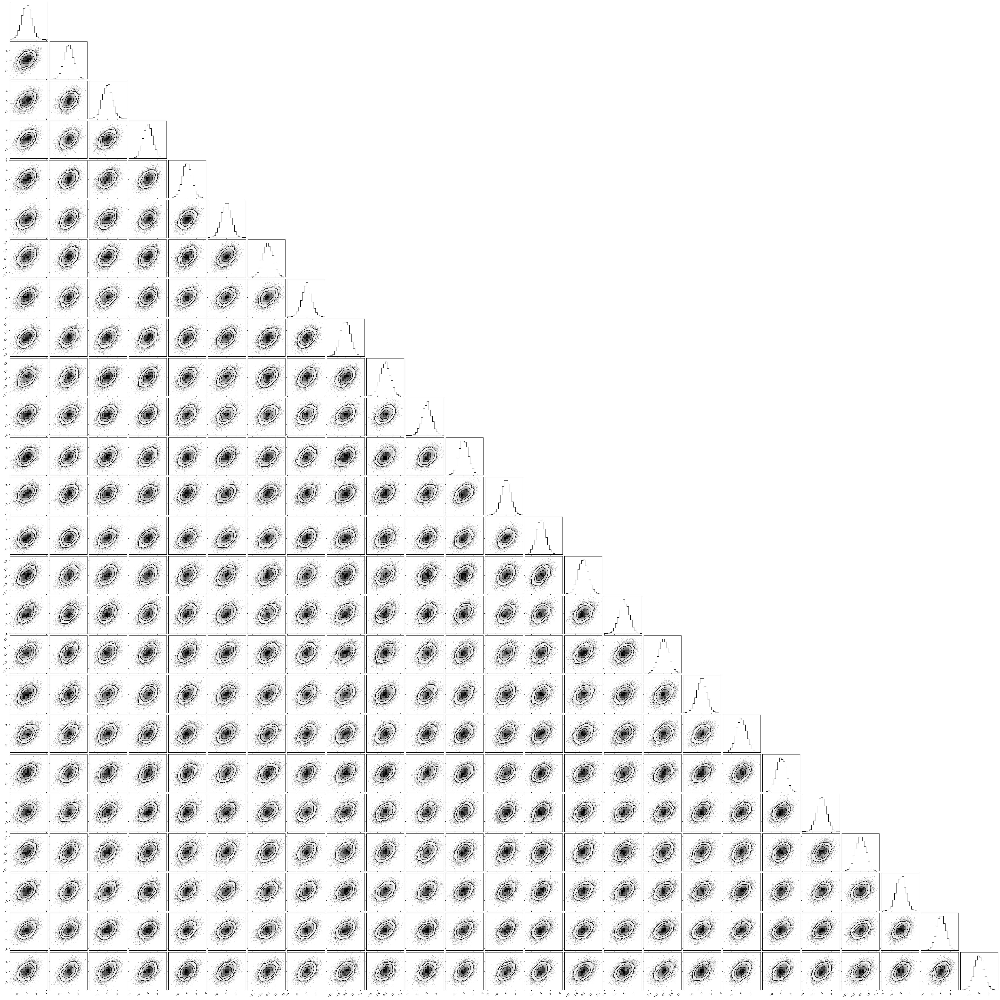

In [7]:
corner.corner(new_samples);

In [8]:
class jikelihood():
    def __init__(self, ndim):
        C = np.identity(ndim)  # set covariance to identity matrix
        C[C==0] = 0.4  # set off-diagonal terms (strongly correlated)
        self.Cinv = np.linalg.inv(C)  # precision matrix
        self.lnorm = -0.5 * (np.log(2 * np.pi) * ndim + np.log(np.linalg.det(C)))  # ln(normalization)

    @partial(jit, static_argnums=(0,))
    def __call__(self, p: np.ndarray):
        return -0.5 * jnp.dot(p, jnp.dot(self.Cinv, p)) + self.lnorm

ndim = 25
logjike = jikelihood(ndim=ndim)
print(logjike(np.random.randn(ndim)))

-39.4785


In [26]:
def grad_u(x):
    return grad(logjike)(x) * 10.0

In [27]:
jampler = NestedSampler(logjike, ptform, ndim, nlive=500, 
                        sample='hslice',
                        gradient=grad_u, 
                        compute_jac=False)

In [28]:
%%time 
jampler.run_nested()

iter: 1778 | bound: 0 | nc: 46 | ncall: 17793 | eff(%):  9.993 | loglstar:   -inf < -127.784 <    inf | logz: -133.772 +/-  0.099 | dlogz: 66.627 >  0.509                                            Traceback (most recent call last):
  File "/Users/grd/Repos/neneneststst/env/lib/python3.9/site-packages/dynesty/dynesty.py", line 895, in __call__
    return self.func(np.asarray(x).copy(), *self.args, **self.kwargs)
  File "/var/folders/40/rzn221yn44nfyyt3kcv2xrcr0000gq/T/ipykernel_4082/1852911541.py", line 2, in grad_u
    return grad(logjike(x)) * 10.0
  File "/Users/grd/Repos/neneneststst/env/lib/python3.9/site-packages/jax/_src/api.py", line 1078, in grad
    value_and_grad_f = value_and_grad(fun, argnums, has_aux=has_aux,
  File "/Users/grd/Repos/neneneststst/env/lib/python3.9/site-packages/jax/_src/api.py", line 1148, in value_and_grad
    _check_callable(fun)
  File "/Users/grd/Repos/neneneststst/env/lib/python3.9/site-packages/jax/_src/api.py", line 181, in _check_callable
    rais

Exception while calling gradient function:
  params: [ 2.82286188  1.04118788 -3.64709808 -0.35825083  1.81106437  3.45615992
 -1.21323497 -3.31327226  0.6913438   1.51744109  4.39380686 -2.25124377
  1.21620161  2.42338982  2.22769072 -3.04392677  4.92826444 -2.17783979
 -0.02773929  1.13025977  2.6333475   1.9846513   0.75050106 -1.03559656
  0.53344187]
  args: []
  kwargs: {}
  exception:


TypeError: Expected a callable value, got -127.79779052734375

In [15]:
jesults = jampler.results
new_jamples = jesults.samples_equal()

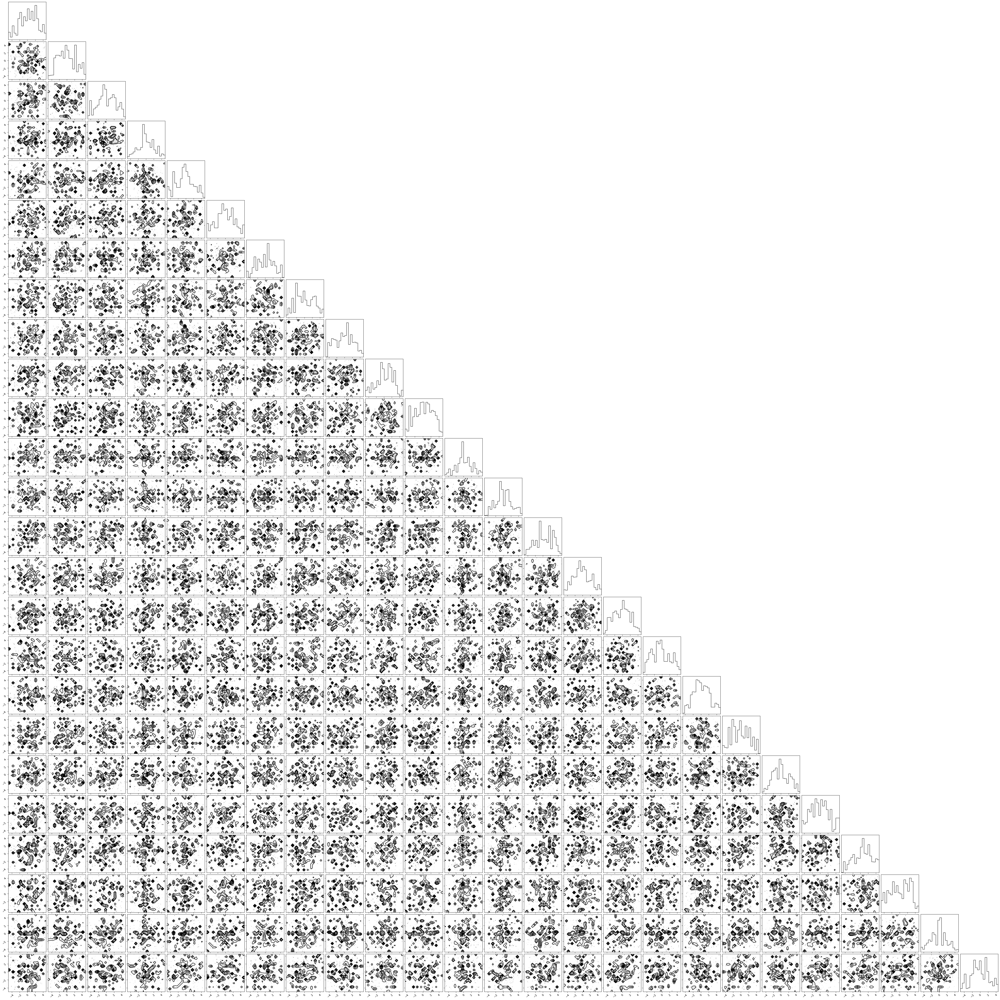

In [16]:
corner.corner(new_jamples);